# AISC2007 DL Assignment2 Group 5

In [ ]:
!pip install --upgrade tensorflow keras

In [ ]:
!pip install opencv-python

#### Importing Necessary Libraries

In [3]:
import os
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from PIL import UnidentifiedImageError
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report, f1_score, precision_score, recall_score, accuracy_score, roc_curve, auc, ConfusionMatrixDisplay, confusion_matrix


In [31]:
# Directory containing images
image_folder = "C:/Users/singh/Downloads/yelp_dataset/photos/processed_images"

In [32]:
#Directory containing imaage metadata
photos_df=pd.read_json("C:/Users/singh/Downloads/yelp_dataset/photos.json", lines=True)

In [33]:
photos_df.head()

,photo_id,business_id,caption,label
0,zsvj7vloL4L5jhYyPIuVwg,Nk-SJhPlDBkAZvfsADtccA,Nice rock artwork everywhere and craploads of ...,inside
1,HCUdRJHHm_e0OCTlZetGLg,yVZtL5MmrpiivyCIrVkGgA,,outside
2,vkr8T0scuJmGVvN2HJelEA,_ab50qdWOk0DdB6XOrBitw,oyster shooter,drink
3,pve7D6NUrafHW3EAORubyw,SZU9c8V2GuREDN5KgyHFJw,Shrimp scampi,food
4,H52Er-uBg6rNrHcReWTD2w,Gzur0f0XMkrVxIwYJvOt2g,,food


In [34]:
photos_df['label'].unique()

array(['inside', 'outside', 'drink', 'food', 'menu'], dtype=object)

In [35]:
photos_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200100 entries, 0 to 200099
Data columns (total 4 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   photo_id     200100 non-null  object
 1   business_id  200100 non-null  object
 2   caption      200100 non-null  object
 3   label        200100 non-null  object
dtypes: object(4)
memory usage: 6.1+ MB


In [36]:
photos_df['label'].isnull().sum()

0

In [37]:
# Count the number of occurrences of each label
label_counts = photos_df['label'].value_counts()
label_counts

label
food       108152
inside      56031
outside     18569
drink       15670
menu         1678
Name: count, dtype: int64

In [38]:
# Sort the counts in descending order (high to low)
sorted_label_counts = label_counts.sort_values(ascending=False)

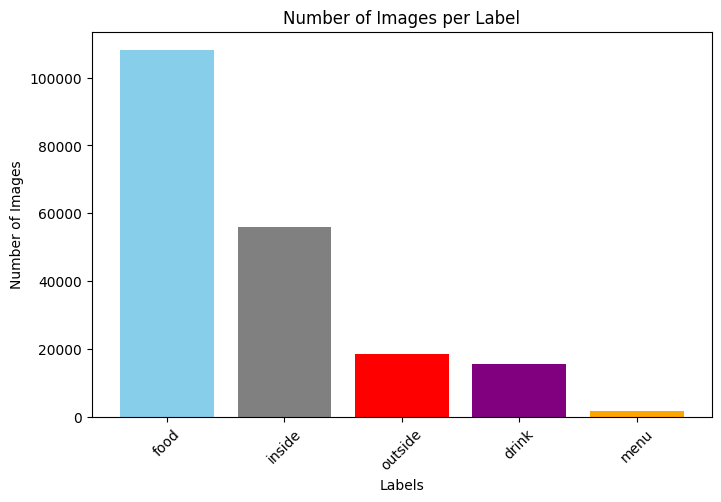

In [39]:
# Plot the bar chart
plt.figure(figsize=(8, 5))
plt.bar(sorted_label_counts.index, sorted_label_counts.values, color=['skyblue', 'grey', 'red', 'purple', 'orange'])

# Add labels and title
plt.xlabel('Labels')
plt.ylabel('Number of Images')
plt.title('Number of Images per Label')
plt.xticks(rotation=45)
plt.show()


In [40]:
def load_images_with_metadata(photo_df, image_folder, max_images_per_label=1678):
    images, labels = [], []
    label_counts = {}  # Dictionary to keep track of loaded images per label

    for index, row in photo_df.iterrows():
        photo_id = row['photo_id']
        label = row['label']

        # Initialize count for the label if it hasn't been already
        if label not in label_counts:
            label_counts[label] = 0

        # Check if the limit has been reached for this label
        if label_counts[label] >= max_images_per_label:
            continue  # Skip loading images for this label if limit is reached

        img_path = os.path.join(image_folder, f"{photo_id}.jpg")  # Adjust extension if needed

        try:
            # Load the image
            img = load_img(img_path, target_size=(128, 128))  # Adjust target size if needed
            img_array = img_to_array(img) / 255.0  # Normalize to [0, 1]
            
            # Append the image and its corresponding label
            images.append(img_array)
            labels.append(label)

            # Increment the count for this label
            label_counts[label] += 1

        except FileNotFoundError:
            print(f"Image {img_path} not found.")
        except UnidentifiedImageError:
            print(f"Skipping {img_path}, not a valid image file.")
        except Exception as e:
            print(f"Error loading {img_path}: {e}")

    # Convert lists to numpy arrays
    X = np.array(images)
    y = np.array(labels)

    return X, y

In [41]:
X, y = load_images_with_metadata(photos_df, image_folder)

# Check the shape of the loaded data
print(f"Loaded {X.shape[0]} images with shape {X.shape[1:]} and {len(y)} labels.")


Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\zsvj7vloL4L5jhYyPIuVwg.jpg not found.
Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\HCUdRJHHm_e0OCTlZetGLg.jpg not found.
Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\vkr8T0scuJmGVvN2HJelEA.jpg not found.
Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\pve7D6NUrafHW3EAORubyw.jpg not found.
Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\H52Er-uBg6rNrHcReWTD2w.jpg not found.
Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\wZ29mUm6nKz566j17OBadw.jpg not found.
Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\QRUgAISgYLQJ9SK2yOwomw.jpg not found.
Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\bb7o8kXXXqc-8PWU6_wcuA.jpg not found.
Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\mcjlyGuLFJ0t4vDixycCSg.jpg not found.
Image C:/Users/singh/Downloads/yelp_dataset/photos/processed\3ROd5PAQ_0OkmoKWVO06ag.jpg not found.
Image C:/U

# Preprocessing

In [43]:
import numpy as np

# Example: Replace with your actual data loading code
X = np.array([])  # or however you're loading X
y = np.array([])  # or however you're loading y

# Check the shapes
print(f"X shape: {X.shape if hasattr(X, 'shape') else len(X)}")
print(f"y shape: {y.shape if hasattr(y, 'shape') else len(y)}")

# Ensure that X and y are not empty before splitting
if X.size == 0 or y.size == 0:
    print("Error: X or y is empty. Please check your data loading and preprocessing.")
else:
    from sklearn.model_selection import train_test_split

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)


X shape: (0,)
y shape: (0,)
Error: X or y is empty. Please check your data loading and preprocessing.


In [42]:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)


ValueError: With n_samples=0, test_size=0.2 and train_size=None, the resulting train set will be empty. Adjust any of the aforementioned parameters.

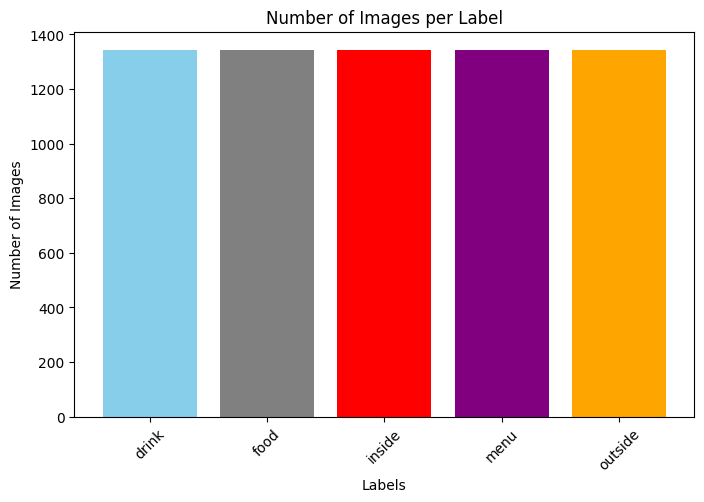

In [19]:
# Count the occurrences of each label
unique, counts = np.unique(y_train, return_counts=True)
sample_label_counts = dict(zip(unique, counts))

# Prepare data for plotting
labels = list(sample_label_counts.keys())
values = list(sample_label_counts.values())

# Plot the bar chart
plt.figure(figsize=(8, 5))
plt.bar(labels, values, color=['skyblue', 'grey', 'red', 'purple', 'orange'])

# Add labels and title
plt.xlabel('Labels')
plt.ylabel('Number of Images')
plt.title('Number of Images per Label')
plt.xticks(rotation=45)
plt.show()


In [20]:
label_encoder = LabelEncoder()

# Fit the label encoder on the training and testing labels and transforming them into numerical values
y_train = label_encoder.fit_transform(y_train)
y_test = label_encoder.transform(y_test)


In [21]:
counts=np.unique(y_train, return_counts=True)
counts

(array([0, 1, 2, 3, 4], dtype=int64),
 array([1342, 1343, 1342, 1342, 1343], dtype=int64))

In [22]:
X_train.shape

(6712, 128, 128, 3)

In [23]:
y_train.shape

(6712,)

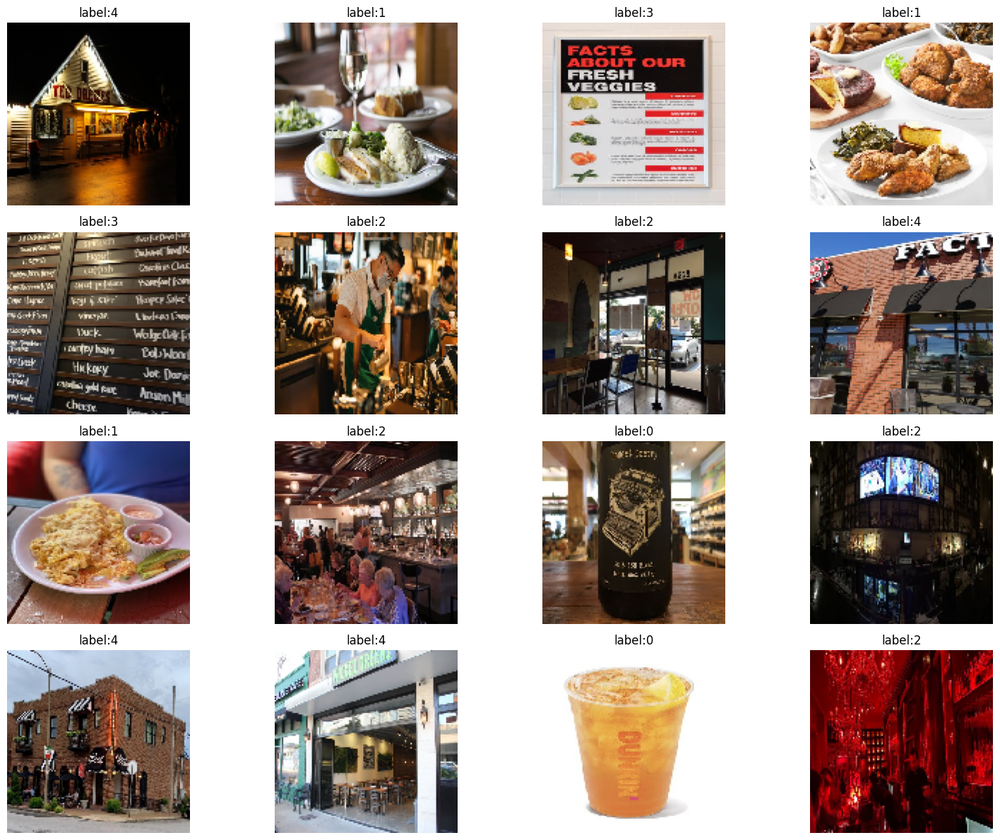

In [24]:
# Set the number of images to display (e.g., 9 images in a 3x3 grid)
num_images = 16
plt.figure(figsize=(16, 12))

# Loop through the number of images and plot each one
for i in range(num_images):
    plt.subplot(4, 4, i + 1)
    plt.imshow(X_train[i])  # Show the image
    plt.title(f'label:{y_train[i]}')  # Show the class label
    plt.axis('off')  # Hide axes

plt.tight_layout()
plt.show()

### DNN Model

In [25]:
# Define image size and batch size
image_size = (128, 128)
batch_size = 32

In [27]:
# Build a DNN model for image classification
model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(128, 128, 3)),  # Define input shape
    tf.keras.layers.Flatten(),                      # Flatten the image data
    tf.keras.layers.Dense(256, activation='relu'),  # Fully connected layer with 256 neurons
    tf.keras.layers.Dropout(0.4),                   # Dropout for regularization
    tf.keras.layers.Dense(128, activation='relu'),  # Fully connected layer with 128 neurons
    tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Dense(64, activation='relu'),    # Fully connected layer with 64 neurons
    tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Dense(32, activation='relu'),    # Fully connected layer with 32 neurons
    tf.keras.layers.Dense(5, activation='softmax')    # Output layer: 5 classes
])

In [28]:
learning_rate=0.0001
optimizer=Adam(learning_rate=learning_rate)
# Compile the model
model.compile(optimizer= optimizer,
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])

# View the model summary
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ flatten_1 (Flatten)             │ (None, 49152)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 256)            │    12,583,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 5)              │           165 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 12,626,565 (48.17 MB)

 Trainable params: 12,626,565 (48.17 MB)

 Non-trainable params: 0 (0.00 B)

In [29]:
# Define early stopping
early_stopping = EarlyStopping(
    monitor='val_loss',  # Metric to monitor
    patience=5,          # Number of epochs to wait for improvement
    restore_best_weights=True  # Restore the best weights after stopping
)

In [30]:
# import numpy as np
# from sklearn.utils.class_weight import compute_class_weight

# # Assuming y_train is your training labels
# class_labels = np.unique(y_train)  # Get unique class labels

# # Compute class weights
# class_weights = compute_class_weight(
#     class_weight='balanced',
#     classes=class_labels,
#     y=y_train
# )

# # Convert class_weights to a dictionary to pass to model.fit()
# class_weight_dict = dict(enumerate(class_weights))

#Abhijeet
Decrease in  Learning Rate decreases the Loss If we have enough epochs

In [37]:
# Train the DNN model
history = model.fit(
    X_train, y_train, 
    validation_data=(X_test, y_test),
    epochs=50,
    batch_size=batch_size,
    callbacks=[early_stopping]
)

Epoch 1/50
210/210 ━━━━━━━━━━━━━━━━━━━━ 12s 57ms/step - accuracy: 0.2441 - loss: 1.5652 - val_accuracy: 0.2944 - val_loss: 1.5390
Epoch 2/50
210/210 ━━━━━━━━━━━━━━━━━━━━ 12s 55ms/step - accuracy: 0.2587 - loss: 1.5627 - val_accuracy: 0.3063 - val_loss: 1.5358
Epoch 3/50
210/210 ━━━━━━━━━━━━━━━━━━━━ 12s 57ms/step - accuracy: 0.2689 - loss: 1.5529 - val_accuracy: 0.3105 - val_loss: 1.5255
Epoch 4/50
210/210 ━━━━━━━━━━━━━━━━━━━━ 13s 60ms/step - accuracy: 0.2523 - loss: 1.5567 - val_accuracy: 0.3039 - val_loss: 1.5257
Epoch 5/50
210/210 ━━━━━━━━━━━━━━━━━━━━ 13s 60ms/step - accuracy: 0.2663 - loss: 1.5473 - val_accuracy: 0.3010 - val_loss: 1.5272
Epoch 6/50
210/210 ━━━━━━━━━━━━━━━━━━━━ 13s 61ms/step - accuracy: 0.2691 - loss: 1.5463 - val_accuracy: 0.3117 - val_loss: 1.5200
Epoch 7/50
210/210 ━━━━━━━━━━━━━━━━━━━━ 12s 59ms/step - accuracy: 0.2732 - loss: 1.5410 - val_accuracy: 0.3111 - val_loss: 1.5158
Epoch 8/50
210/210 ━━━━━━━━━━━━━━━━━━━━ 13s 60ms/step - accuracy: 0.2640 - loss: 1.5488 - 

In [38]:
loss, test_accuracy = model.evaluate(X_test, y_test)
print("Test_accuracy: " ,test_accuracy)

# checking train accuracy
loss, train_accuracy = model.evaluate(X_train, y_train)
print("Train_accuracy: " ,train_accuracy)

53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.3188 - loss: 1.5065
Test_accuracy:  0.31346842646598816
210/210 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.3347 - loss: 1.4802
Train_accuracy:  0.33179381489753723


In [39]:
y_predict = model.predict(X_test)
y_predict_classes = tf.argmax(y_predict, axis=1).numpy()  # Get predicted class indices

53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [41]:
# Step 2: Convert probabilities to class labels
y_pred = np.argmax(y_predict, axis=1)

In [42]:
print("Classification Report:")
print(classification_report(y_test, y_predict_classes))

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       336
           1       0.25      0.82      0.38       335
           2       0.22      0.12      0.15       336
           3       0.33      0.01      0.01       336
           4       0.55      0.62      0.59       335

    accuracy                           0.31      1678
   macro avg       0.27      0.31      0.23      1678
weighted avg       0.27      0.31      0.23      1678



C:\Users\singh\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\singh\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\singh\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\sklearn\metrics\_classificati

#Abhijeet
Model is strugling to identify Class 2 and But good with class 1, neither bad nor good Class 4 prediction
Now i will Try Few Things
1. Using Class weight may be class are imbalance (Possible)/ Data augmentation
2. Adjust model Complexity
3

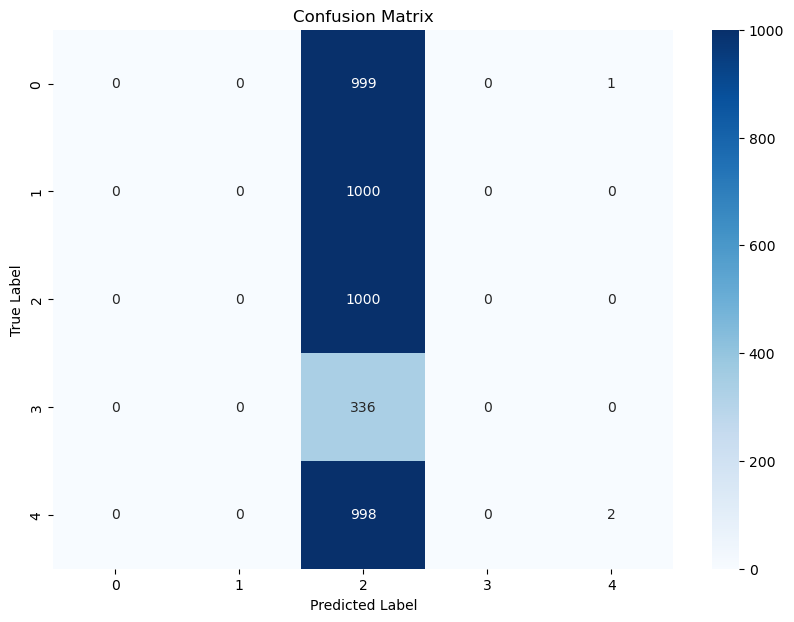

In [488]:
import seaborn as sns
# Create confusion matrix
cm = confusion_matrix(y_test, y_predict_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=range(5), yticklabels=range(5))
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

## CNN Model

In [497]:
model = tf.keras.Sequential()

# First Convolutional Layer
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(128, 128, 3)))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))

# Second Convolutional Layer
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))

# Third Convolutional Layer
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))

# Flattening the output
model.add(Flatten())

# Fully Connected Layer
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))

# Output Layer
model.add(Dense(5, activation='softmax'))

In [498]:
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [499]:
history = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=5, batch_size=32)

Epoch 1/5
542/542 ━━━━━━━━━━━━━━━━━━━━ 324s 581ms/step - accuracy: 0.3348 - loss: 1.9708 - val_accuracy: 0.5673 - val_loss: 1.2919
Epoch 2/5
542/542 ━━━━━━━━━━━━━━━━━━━━ 311s 573ms/step - accuracy: 0.4326 - loss: 1.3193 - val_accuracy: 0.4548 - val_loss: 1.6492
Epoch 3/5
542/542 ━━━━━━━━━━━━━━━━━━━━ 293s 541ms/step - accuracy: 0.4938 - loss: 1.1765 - val_accuracy: 0.6257 - val_loss: 0.9947
Epoch 4/5
542/542 ━━━━━━━━━━━━━━━━━━━━ 240s 444ms/step - accuracy: 0.5550 - loss: 1.0756 - val_accuracy: 0.6845 - val_loss: 0.8804
Epoch 5/5
542/542 ━━━━━━━━━━━━━━━━━━━━ 253s 467ms/step - accuracy: 0.6022 - loss: 0.9720 - val_accuracy: 0.6958 - val_loss: 0.9098
